In [2]:
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

import re

import json
import bbcode
from nltk.corpus import stopwords

import gensim
import nltk
from nltk import bigrams, trigrams
from gensim.corpora import Dictionary

import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

from nltk.stem.porter import *
from nltk.stem import WordNetLemmatizer
from sentence_transformers import SentenceTransformer
from umap import UMAP
from hdbscan import HDBSCAN
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from sklearn.feature_extraction.text import CountVectorizer
from bertopic.vectorizers import ClassTfidfTransformer
from gensim.models.coherencemodel import CoherenceModel

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF

from bertopic import BERTopic

import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

In [3]:
def reduce_mem_usage(df):
    """ iterate through all the columns of a dataframe and modify the data type
        to reduce memory usage.        
    """
    start_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage of dataframe is {:.2f} MB'.format(start_mem))
    
    for col in df.columns:
        col_type = df[col].dtype
        
        if col_type != object:
            c_min = df[col].min()
            c_max = df[col].max()
            if str(col_type)[:3] == 'int':
                if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                    df[col] = df[col].astype(np.int8)
                elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                    df[col] = df[col].astype(np.int16)
                elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                    df[col] = df[col].astype(np.int32)
                elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                    df[col] = df[col].astype(np.int64)  
            else:
                if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                    df[col] = df[col].astype(np.float16)
                elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                    df[col] = df[col].astype(np.float32)
                else:
                    df[col] = df[col].astype(np.float64)


    end_mem = df.memory_usage().sum() / 1024**2
    print('Memory usage after optimization is: {:.2f} MB'.format(end_mem))
    print('Decreased by {:.1f}%'.format(100 * (start_mem - end_mem) / start_mem))
    
    return df


def import_data(file):
    """create a dataframe and optimize its memory usage"""
    df = pd.read_csv(file, parse_dates=True, keep_date_col=True)
    df = reduce_mem_usage(df)
    return df

def import_data_small(file):
    """create a dataframe and optimize its memory usage"""
    df = pd.read_csv(file, parse_dates=True, keep_date_col=True)
    df = reduce_mem_usage(df)
    return df

In [4]:
# This code takes over a minute to run
steam_reviews = import_data_small('apex_legends.csv')
steam_reviews.info()

Memory usage of dataframe is 8.96 MB
Memory usage after optimization is: 6.10 MB
Decreased by 31.9%
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 17 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   recommendationid             100000 non-null  int32  
 1   author                       100000 non-null  object 
 2   language                     100000 non-null  object 
 3   review                       99996 non-null   object 
 4   timestamp_created            100000 non-null  int32  
 5   timestamp_updated            100000 non-null  int32  
 6   voted_up                     100000 non-null  float16
 7   votes_up                     100000 non-null  int16  
 8   votes_funny                  100000 non-null  int16  
 9   weighted_vote_score          100000 non-null  float16
 10  comment_count                100000 non-null  int16  
 11  steam_purchase    

In [5]:
steam_reviews.iloc[289]['author']

"{'steamid': '76561198097712283', 'num_games_owned': 471, 'num_reviews': 7, 'playtime_forever': 46737, 'playtime_last_two_weeks': 0, 'playtime_at_review': 45422, 'last_played': 1724505633}"

In [6]:


# Convert 'author' column to dictionary format
steam_reviews['author'] = steam_reviews['author'].apply(lambda x: json.loads(x.replace("'", "\"")))

# Normalize and rename columns, adding 'author_' prefix
steam_reviews_expanded = pd.json_normalize(steam_reviews['author']).add_prefix('author_')

# Concatenate the expanded columns back to the original DataFrame and drop the 'author' column
steam_reviews = pd.concat([steam_reviews_expanded, steam_reviews.drop(columns=['author'])], axis=1)

# print(steam_reviews)

In [7]:
steam_reviews.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 24 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   author_steamid                  100000 non-null  object 
 1   author_num_games_owned          100000 non-null  int64  
 2   author_num_reviews              100000 non-null  int64  
 3   author_playtime_forever         100000 non-null  int64  
 4   author_playtime_last_two_weeks  100000 non-null  int64  
 5   author_playtime_at_review       100000 non-null  int64  
 6   author_last_played              100000 non-null  int64  
 7   author_deck_playtime_at_review  943 non-null     float64
 8   recommendationid                100000 non-null  int32  
 9   language                        100000 non-null  object 
 10  review                          99996 non-null   object 
 11  timestamp_created               100000 non-null  int32  
 12  timestamp_updated

In [8]:
steam_reviews['language'].unique()

array(['english'], dtype=object)

In [9]:
steam_reviews = steam_reviews.dropna(subset=['review'])


In [10]:
steam_reviews = steam_reviews[(steam_reviews['language'] == 'english') & steam_reviews['review'].map(lambda x: x.isascii())]


## To drop irrelevant columns

In [11]:
steam_reviews.drop(columns=['recommendationid','language','votes_up','votes_funny','weighted_vote_score',
                           'steam_purchase','received_for_free','written_during_early_access','hidden_in_steam_china','steam_china_location',
                           'primarily_steam_deck', 'author_playtime_last_two_weeks', 'author_deck_playtime_at_review','author_playtime_at_review', 'author_last_played'], inplace=True)
steam_reviews.reset_index(drop=True, inplace=True)

In [12]:
# To handle float object reviews where sometimes the review section consists of nan (float type)

review_lengths = [len(x.split()) if isinstance(x,str) else 0 for x in steam_reviews['review']]
print(len(review_lengths))
print(sum(review_lengths)/len(review_lengths)) # mean character length of a review
steam_reviews['review_length']=steam_reviews['review'].map(lambda x: len(x.split()) if isinstance(x, str) else 0)

96023
45.55916811597221


In [13]:
# for x in steam_reviews['review']:
#     if not isinstance(x, str):
#         print(x)

In [14]:
# Checking the length of reviews to find those that are suspected to be spam
steam_reviews.head()

,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_created,timestamp_updated,voted_up,comment_count,review_length
0,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,1604550435,1637267971,1.0,117,58
1,76561198091477605,29,4,99460,"Now with the new battle pass system, I'm delet...",1720453574,1720453574,0.0,77,17
2,76561198295880474,41,4,40661,Game freezes every session i play with the new...,1719498326,1719498326,0.0,0,13
3,76561198016708638,160,36,33212,You open the game and finish your 3000 word es...,1643340456,1643340456,1.0,59,315
4,76561199442688562,43,1,85469,"Apex is like your neighbor's sister, she treat...",1721366329,1721366329,0.0,11,66


In [15]:
# Filter rows where the length of the 'review' text is less than 3 words
steam_reviews[steam_reviews['review'].map(lambda x: len(str(x).split()) < 3)]


,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_created,timestamp_updated,voted_up,comment_count,review_length
2781,76561199030597557,0,4,6000,.,1663304937,1726642206,1.0,0,1
6025,76561199067635786,0,2,52965,Games cooked,1721376802,1727967575,0.0,0,2
7988,76561197993606466,0,20,154883,stupid ea,1721409148,1727034109,0.0,0,2
8116,76561198398919832,23,3,35971,better now,1721255982,1725567291,1.0,0,2
8124,76561198321043473,26,2,35179,.,1721243090,1727855635,0.0,0,1
...,...,...,...,...,...,...,...,...,...,...
94301,76561198283229526,103,11,30724,game sucsks,1649468997,1725664614,0.0,0,2
94812,76561199135803169,0,16,5135,"/.,/,./,/./,/,./,./,./,/,./,./,/,/,./,./,./,./,./",1708846159,1708846159,1.0,0,1
94868,76561198042614186,0,34,1637,.,1702812812,1724526950,1.0,0,1
95134,76561198415907075,68,14,24328,absolute ...,1675823653,1675823653,1.0,0,2


In [16]:
# need convert this timesteamp created column to datetype object
steam_reviews['timestamp_created'].dtype

dtype('int32')

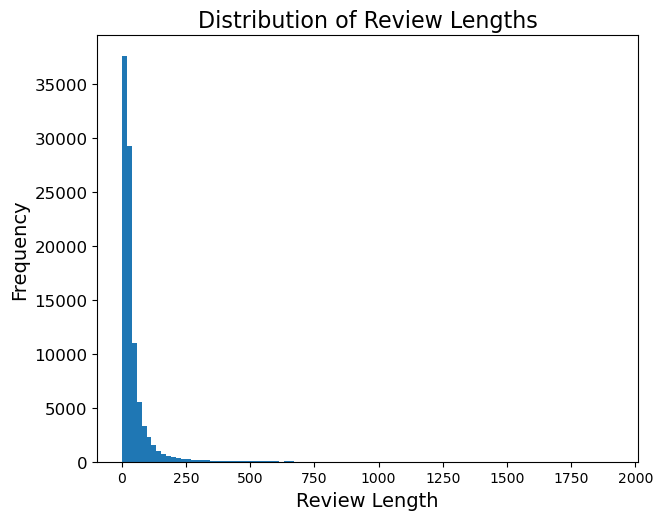

<Figure size 1000x1000 with 0 Axes>

In [17]:
plt.hist(steam_reviews['review_length'], bins=100)
plt.tight_layout()
plt.yticks(fontsize=12) 

plt.xlabel('Review Length', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.title('Distribution of Review Lengths', fontsize=16)
plt.figure(figsize=(10, 10))

plt.show()

In [18]:
# Filter reviews that is too short

#cut off review lengths at the 25th percentile. 
#Short reviews contain too little info, but we can't discard too much data either.
np.percentile(steam_reviews['review_length'],3) # If more than 3.0 words

steam_reviews_filtered = steam_reviews[steam_reviews['review_length'] > np.percentile(steam_reviews['review_length'],3)].reset_index(drop=True) 
#Remove very short reviews that are likely to be junk

print('Min length:',min(steam_reviews_filtered['review_length']),'words') #shortest review length.

Min length: 9 words


In [19]:
steam_reviews_filtered['review'].value_counts()

review
Before i played Apex Legends, i had a small wee-wee, no friends, no girlfriend, depression, and absolutely no life. These things haven't changed, but the game is pretty good.                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                   

## Review Spam/Ham Problem
Some reviews have been spammed multiple times, or just happen to come out the same.
All reviewers' opinions are important, but repeated reviews sometimes originate from one player.
Removing duplicates controls the "vocal minority" problem effectively.
Need to clean away any text that is not strictly English. It is possible for text from other languages to be wrongly labelled as English. (Reviews scraped were all labelled as being in English)

In [20]:
# drop duplicate entries in reviews, because they are considered spam
steam_reviews_filtered2 = steam_reviews_filtered.drop_duplicates(subset=['author_steamid', 'review'])
len(steam_reviews_filtered2)

deduplicated_rows = abs(len(steam_reviews_filtered2) - len(steam_reviews_filtered)) #find out how many rows were removed during deduplication
print(deduplicated_rows)
print(deduplicated_rows/len(steam_reviews_filtered)) #Percentage of data that was duplicated

4
4.315460135936994e-05


In [21]:
steam_reviews_filtered2.select_dtypes(include='O').describe()

,author_steamid,review
count,92686,92686
unique,92686,92353
top,76561198273957109,"Before i played Apex Legends, i had a small we..."
freq,1,35


### Text Cleaning
- Transforming int32 dtype timestamp_created and timestamp_updated to datetime format.
- BBCode

Steam reviews use BBCode, a form of markup language used to format bulletin board posts (hence the name).

Regex can be used to clean this out, but there is a pre-built package for this exact purpose.

No need to reinvent the wheel.

- Lowercase
- Contractions
- Punctuation removal
- Numeral to words
- Stopword removal

In [22]:
with open('contra_dict.txt') as contra_dict:
    cList = json.load(contra_dict)  # Load into a python dictionary
    # print(cList)
    cList = {key.lower(): value for key, value in cList.items()}  # Convert keys to lowercase for matching
    # print(cList)  # Debug print

# Create a regex pattern with all the contractions
c_re = re.compile('(%s)' % '|'.join(cList.keys()))
# print(c_re)

# Function to expand contractions
def expandContractions(text, c_re=c_re):
    def replace(match):
        # print(f"Expanding: {match.group(0)} to {cList[match.group(0)]}")  # Debug print
        return cList[match.group(0)]
    return c_re.sub(replace, text.lower())  # Substitutes the contractions

In [23]:
parser=bbcode.Parser()


In [24]:
def remove_bbcode(text):
    # Pattern to match BBCode tags: [tag]content[/tag] or [tag]
    # It matches anything between square brackets, including the brackets.
    bbcode_pattern = re.compile(r'\[/?[^\]]+\]')

    text_without_bbcode = re.sub(bbcode_pattern, '', text)
    
    return text_without_bbcode

sample_text = "This is a [b]bold[/b] text and [url=http://example.com]link[/url]."
clean_text = remove_bbcode(sample_text)
print(clean_text)

This is a bold text and link.


In [25]:
#define stopwords (common words with no meaning by themselves)

num_dict = {'0':'zero',
            '1':'one',
            '2':'two',
            '3':'three',
            '4':'four',
            '5':'five',
            '6':'six',
            '7':'seven',
            '8':'eight',
            '9':'nine',
            #'i':'one',      skipped. Using Roman numeral 'i' will conflict with the pronoun "I", which is not a number
            'ii':'two',
            'iii':'three'   
            }

def num2word(d):
    
    if (len(d) == 1 and d in '0123456789')  or (d in ['ii','iii']):
        word = num_dict[d] # Convert numbers 0123 to the number in word form
    
    elif (len(str(d))==1 and str(d) in '0123'):
        word = num_dict(str(d))

    else:
        word = d
    
    return word

# en_stopwords = list(set(STOPWORDS)) # method from SteamVox, currently using Wk2 Lab method
en_stopwords = stopwords.words('english')

en_stopwords.extend(['amazing', 'smooth', 'awesome', 'playful','fast', 'good','better','sorry','positive','fast','yes','no'
                     'dogshit','negative', 'bad','highly','recommend','recommended','fun','fuck','suck','shit', 'best', 'great','lot','game','like','I','i', 'love', 'this', 'play', 'played', 'ever', 'thank', 'thank you', 'thanks', 'hey', 'hey sir', 'sir', "lol"])
en_stopwords.extend(['apex'])    # remove game names
en_stopwords.extend(['ea', 'electronic arts'])    # remove publishers and developers

en_stopwords = [w for w in en_stopwords if w not in ['one','two','three']]    #retain these for making n-grams

def remove_stopwords(doc):
    words = [num2word(w) for w in doc if w != '' and w not in en_stopwords]
    return words


In [26]:
def parse_clean(text):
    
    text = remove_bbcode(text) # remove BBcode notations from text

    text = expandContractions(text) # expand contractions; return all text in lower case

    text = re.split(r'\W+',text) # separate words from punctuation (e.g. remove 's from "Cao Cao's")

    text = [num2word(w) for w in text] # convert single digits to words before word len check, or they will be lost
    
    # stemmer = PorterStemmer()
    # text = [stemmer.stem(w) for w in text]

    lemmatizer = WordNetLemmatizer()
    text =  [lemmatizer.lemmatize(word) for word in text]

    #All word lengths should be >1 character and <= length of the longest word in the English language. It's common for people spam incoherent letters on the Internet.
    text = [word for word in text if word not in en_stopwords and len(word)>1 and len(word) <= len('pneumonoultramicroscopicsilicovolcanoconiosis')] 

    text = [word for word in text if re.search('^[a-z]+$',word)]
    #clean_text = [num2word(w) for w in text] #just in case any lone numbers appeared after cleaning
    
    return text

se = "Too many cheaters for the game to actually be fun, and Respawn seems to not care about that, but instead added leave penalties for pub matches. It was boring and don't waste your time. Run of the mill doodoo royale"
print(parse_clean(se))


['many', 'cheater', 'actually', 'respawn', 'seems', 'care', 'instead', 'added', 'leave', 'penalty', 'pub', 'match', 'boring', 'iste', 'time', 'run', 'mill', 'doodoo', 'royale']


In [27]:
steam_reviews_filtered2.head()

,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_created,timestamp_updated,voted_up,comment_count,review_length
0,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,1604550435,1637267971,1.0,117,58
1,76561198091477605,29,4,99460,"Now with the new battle pass system, I'm delet...",1720453574,1720453574,0.0,77,17
2,76561198295880474,41,4,40661,Game freezes every session i play with the new...,1719498326,1719498326,0.0,0,13
3,76561198016708638,160,36,33212,You open the game and finish your 3000 word es...,1643340456,1643340456,1.0,59,315
4,76561199442688562,43,1,85469,"Apex is like your neighbor's sister, she treat...",1721366329,1721366329,0.0,11,66


In [28]:
import datetime

def timestamp_to_datetime(timestamp):
    dt_object = datetime.datetime.fromtimestamp(timestamp)
    return dt_object

steam_reviews_filtered2['timestamp_created'] = steam_reviews_filtered2['timestamp_created'].apply(lambda x: timestamp_to_datetime(x))
steam_reviews_filtered2['timestamp_updated'] = steam_reviews_filtered2['timestamp_updated'].apply(lambda x: timestamp_to_datetime(x))

steam_reviews_filtered2['timestamp_created'] = steam_reviews_filtered2['timestamp_created'].apply(lambda x: x.date())
steam_reviews_filtered2['timestamp_updated'] = steam_reviews_filtered2['timestamp_updated'].apply(lambda x: x.date())


steam_reviews_filtered2['author_playtime_forever'] = steam_reviews_filtered2['author_playtime_forever'].apply(lambda x: x/60)


### Tokenize into words

In [29]:
# Apply parse_clean() to every review into new column 'clean_review'
steam_reviews_filtered2['clean_review'] = steam_reviews_filtered2['review'].map(lambda x: parse_clean(x))

In [30]:
steam_reviews_filtered2.head()

,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_created,timestamp_updated,voted_up,comment_count,review_length,clean_review
0,76561198273957109,193,16,546.033333,doesnt launch with origin\n\nedit: easy anti-c...,2020-11-05,2021-11-19,1.0,117,58,"[doe, launch, origin, edit, easy, anti, cheat,..."
1,76561198091477605,29,4,1657.666667,"Now with the new battle pass system, I'm delet...",2024-07-08,2024-07-08,0.0,77,17,"[new, battle, pas, system, deleting, well, pla..."
2,76561198295880474,41,4,677.683333,Game freezes every session i play with the new...,2024-06-27,2024-06-27,0.0,0,13,"[freeze, every, session, new, update, literall..."
3,76561198016708638,160,36,553.533333,You open the game and finish your 3000 word es...,2022-01-28,2022-01-28,1.0,59,315,"[open, finish, word, essay, due, tomorrow, loa..."
4,76561199442688562,43,1,1424.483333,"Apex is like your neighbor's sister, she treat...",2024-07-19,2024-07-19,0.0,11,66,"[neighbor, sister, treat, utmost, tenderness, ..."


In [29]:
def convert_to_str(list_review):
        return ' '.join(list_review)

steam_reviews_filtered2['clean_review_str'] = steam_reviews_filtered2['clean_review'].map(lambda x: convert_to_str(x))

In [30]:
steam_reviews_filtered2['clean_review_str'].iloc[0]

'doe launch origin edit easy anti cheat banned false support believe careful software ur pc support edit two randomly got un banned two month later review know reviewed support said case closed anyways'

#### Model 2: BERTopic
BERTopic is a package for Topic Modelling using HuggingFace transformers and class-based TF-IDF. BERTopic is a highly flexible modular package so that you can tailor it to your needs.
https://maartengr.github.io/BERTopic/getting_started/quickstart/quickstart.html

In [106]:
# Embedding model - extract embeddings
from sentence_transformers import SentenceTransformer

embedding_model = SentenceTransformer("all-MiniLM-L6-v2")

In [107]:
# UMAP model - reduce dimensionality
umap_model = UMAP(n_neighbors=15, n_components=5, 
                  min_dist=0.0, metric='cosine', random_state=42)

In [108]:
# HDBscan model - reduce topic outliers
hdbscan_model = HDBSCAN(min_cluster_size=10, metric='euclidean', 
                        cluster_selection_method='eom', prediction_data=True, min_samples=5)

In [109]:
# c-TF-IDF - identify the most representative words for each topic
ctfidf_model = ClassTfidfTransformer()

In [35]:
# Only need to train once, afte that can save the model using pickle
# TAKE AWHILE - 11 mins (Only need run once after that save it using topic_model.save -> Go to conclusion to view it)
steam_reviews_bert = steam_reviews_filtered2
topic_model = BERTopic(embedding_model=embedding_model, umap_model=umap_model, hdbscan_model=hdbscan_model, ctfidf_model=ctfidf_model)

topics, probs = topic_model.fit_transform(steam_reviews_bert['clean_review_str'])

In [111]:
# To save our model after training 
# import pickle
# pickle.dump(topic_model , open('bertopic_model.pk1' , 'wb'))

# Saving the model (BERTopic):
embedding_model = "bertopic_model2"
topic_model.save("/Users/ahminhui/Desktop/social_analytics/Project/bertopic_model2", serialization="safetensors", save_ctfidf=True, save_embedding_model=embedding_model)

In [31]:
embedding_model = SentenceTransformer("all-MiniLM-L6-v2")
topic_model =  BERTopic.load("bertopic_model2", embedding_model=embedding_model)
# topics, probs = topic_model.fit_transform(steam_reviews_bert['clean_review_str'])

No sentence-transformers model found with name bertopic_model2. Creating a new one with MEAN pooling.
2024-10-26 22:21:59,027 - BERTopic - WARNING: You are loading a BERTopic model without explicitly defining an embedding model.If you want to also load in an embedding model, make sure to useBERTopic.load(my_model, embedding_model=my_embedding_model).


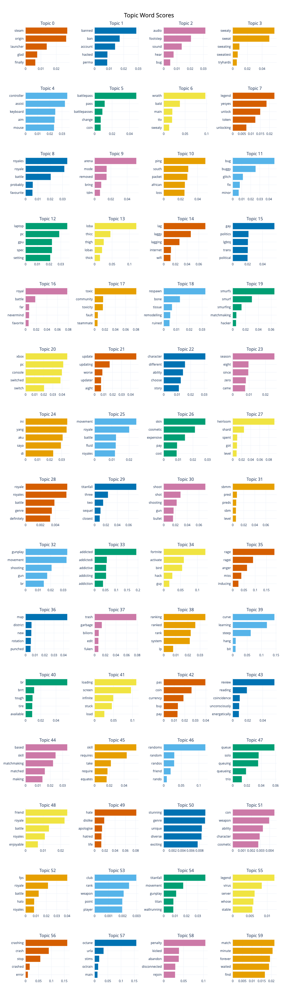

In [32]:
# Visualise top 15 topics and top 5 most common words for each topic
topic_model.visualize_barchart(top_n_topics =60, n_words = 5)

<h1> Discussion </h1>
Let's take a moment to discuss some of the topics generated! 

If we take a closer look at topic 2, we can see that there are semantically related words combined such as 'audio', 'sound', 'footstep', 'bug' and 'hear'. Based on human judgment it can be assumed that the topic  likely point to the ongoing discussions or complaints about audio problems in Apex Legends, especially regarding how well players can hear enemy footsteps.

Another example can be topic 11 as it contains terms such as 'bug' and 'glitch', this can lead us to the assumption that the topic is about subject concerning technical stability of the game. 

For topic 8, the common terms such as 'royales' and 'battle' tells us about the genre of the game. 

For topic 20, the common terms such as 'xbox', 'pc' and 'switch' tells us about the cross-platform play Apex Legends offer and how this impose performance differences between different devices. 

For topic 32, the common terms such as "gunplay," "movement," "shooting," and "BR" is more about the specific mechanics of combat within Apex Legends, such as how guns handle, how players move during fights, and how gunfights are played out in the BR (Battle Royale) environment.

There are other interesting topics too such as Topic 22 which talks about character in the game. For simplicity purposes, we only focus on these topics:-

* Topic 2: Audio Reliability
* Topic 11: Technical Stability
* Topic 8: Genre
* Topic 20: Cross-Platform
* Topic 32: Gameplay Mechanics

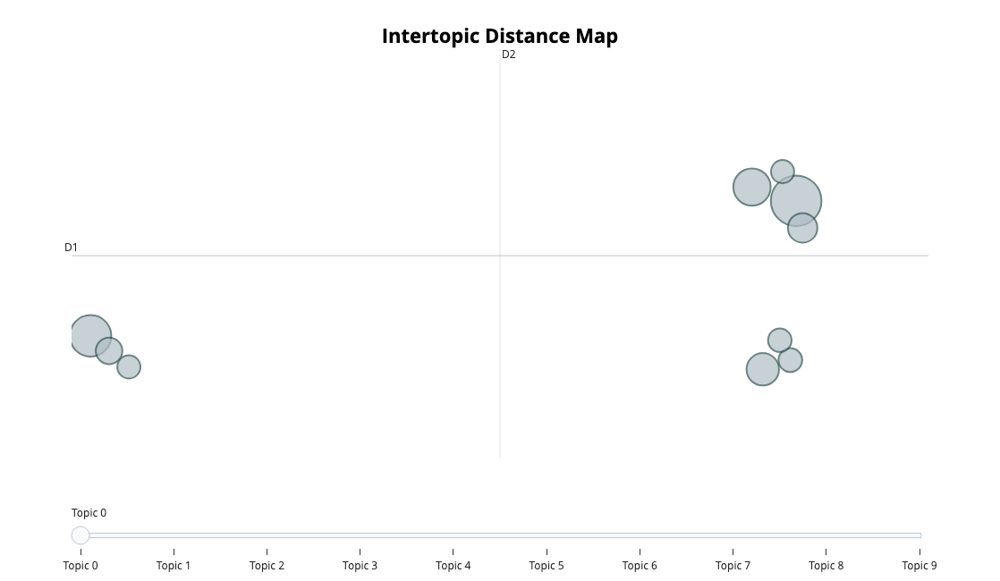

In [33]:
topic_model.visualize_topics(top_n_topics = 10)



Topic 2: Audio Reliability


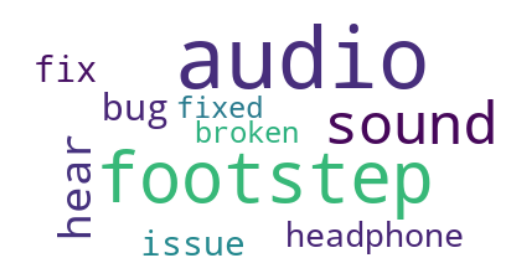

Topic 8: Genre


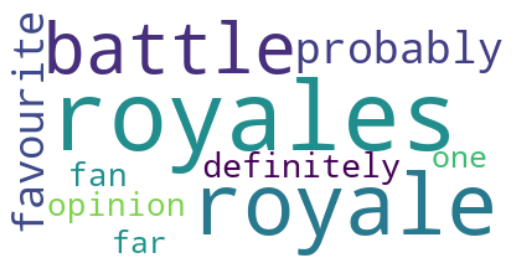

Topic 11: Technical Stability


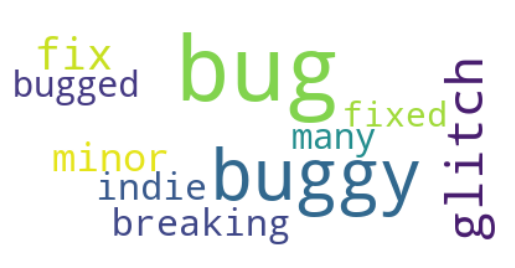

Topic 20: Cross-Platform


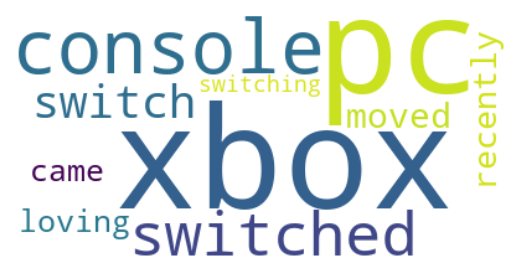

Topic 32: Gameplay Mechanics


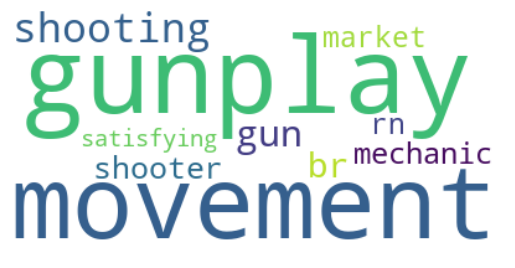

<Figure size 640x480 with 0 Axes>

In [34]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

def create_wordcloud(model, topic):
    text = {word: value for word, value in model.get_topic(topic)}
    wc = WordCloud(background_color="white", max_words=1000)
    wc.generate_from_frequencies(text)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show()

# Show wordcloud
print("Topic 2: Audio Reliability")
create_wordcloud(topic_model, 2)

print("Topic 8: Genre")
create_wordcloud(topic_model, 8)

print("Topic 11: Technical Stability")
create_wordcloud(topic_model, 11)

print("Topic 20: Cross-Platform")
create_wordcloud(topic_model, 20)

print("Topic 32: Gameplay Mechanics")
create_wordcloud(topic_model, 32)




# topics = topic_model.get_topics(1)
# for i, topic in enumerate(topics):
#     create_wordcloud(topic_model, topic=i)
    
plt.tight_layout()
plt.show()

In [366]:
from gensim.models.coherencemodel import CoherenceModel

# print(len(topics))

documents =  pd.DataFrame({"Document": steam_reviews_bert['clean_review_str'],
                          "ID": range(len(steam_reviews_bert['clean_review_str'])),
                          "Topic": topics})

In [367]:
documents_per_topic = documents.groupby(['Topic'], as_index=False).agg({'Document': ' '.join})
cleaned_docs = topic_model._preprocess_text(documents_per_topic.Document.values)

In [103]:
import gensim.corpora as corpora
vectorizer_model = CountVectorizer(stop_words="english")

# Extract vectorizer and analyzer from BERTopic
vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Extract features for Topic Coherence evaluation
# vectorizer_model = CountVectorizer(stop_words="english")
# words = vectorizer.get_feature_names()
tokens = [analyzer(doc) for doc in cleaned_docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = [[words for words, _ in topic_model.get_topic(topic)] 
               for topic in range(len(set(topics))-1)]

# Evaluate
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_v')
coherence = coherence_model.get_coherence()


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [104]:
print(coherence)

0.5734399754085043


In [105]:
topic_model.get_topic_info().head(14)


,Topic,Count,Name,Representation,Representative_Docs
0,-1,45725,-1_player_ha_season_new,"[player, ha, season, new, time, skin, get, pla...",NaN
1,0,2517,0_steam_origin_launcher_glad,"[steam, origin, launcher, glad, finally, versi...",NaN
2,1,1690,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN
3,2,1368,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN
4,3,1033,3_sweaty_sweat_sweating_sweatiest,"[sweaty, sweat, sweating, sweatiest, tryhards,...",NaN
5,4,856,4_controller_assist_keyboard_aim,"[controller, assist, keyboard, aim, mouse, mnk...",NaN
6,5,692,5_battlepass_pass_battlepasses_change,"[battlepass, pass, battlepasses, change, coin,...",NaN
7,6,553,6_wraith_bald_main_ttv,"[wraith, bald, main, ttv, sweaty, octane, wing...",NaN
8,7,543,7_legend_yesyes_unlock_token,"[legend, yesyes, unlock, token, unlocking, pay...",NaN
9,8,528,8_royales_royale_battle_probably,"[royales, royale, battle, probably, favourite,...",NaN


In [107]:
# Return top n words for a Audio Reliability topic and their c-TF-IDF scores
topic_model.get_topic(2)

[['audio', 0.031551802029906914],
 ['footstep', 0.02068419359116341],
 ['sound', 0.013674743166544727],
 ['hear', 0.007533836860983535],
 ['bug', 0.004988818612893209],
 ['fix', 0.004529355342656659],
 ['issue', 0.004366994909878495],
 ['headphone', 0.004145173498701676],
 ['broken', 0.0031797091669757806],
 ['fixed', 0.003117904822381319]]

In [108]:
topic_model.get_document_info(steam_reviews_bert['clean_review_str'])


,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Representative_document
0,doe launch origin edit easy anti cheat banned ...,1,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN,banned - ban - account - hacked - perma - reas...,False
1,new battle pas system deleting well player bye,308,308_deleting_bye_spin_button,"[deleting, bye, spin, button, pas, system, uni...",NaN,deleting - bye - spin - button - pas - system ...,False
2,freeze every session new update literally unpl...,183,183_crashing_update_freeze_crash,"[crashing, update, freeze, crash, crashed, ses...",NaN,crashing - update - freeze - crash - crashed -...,False
3,open finish word essay due tomorrow load main ...,267,267_caustic_hamster_menu_ttv,"[caustic, hamster, menu, ttv, zone, juiced, tr...",NaN,caustic - hamster - menu - ttv - zone - juiced...,False
4,neighbor sister treat utmost tenderness bring ...,-1,-1_player_ha_season_new,"[player, ha, season, new, time, skin, get, pla...",NaN,player - ha - season - new - time - skin - get...,False
...,...,...,...,...,...,...,...
92681,nice much action performed,347,347_creativity_puzzle_amazed_action,"[creativity, puzzle, amazed, action, attention...",NaN,creativity - puzzle - amazed - action - attent...,False
92682,free worth playing friend,-1,-1_player_ha_season_new,"[player, ha, season, new, time, skin, get, pla...",NaN,player - ha - season - new - time - skin - get...,False
92683,sometimes make forget pain im making depressed,-1,-1_player_ha_season_new,"[player, ha, season, new, time, skin, get, pla...",NaN,player - ha - season - new - time - skin - get...,False
92684,hello name derek mcalisster take nine inch dil...,313,313_anal_gum_vaginal_asshole,"[anal, gum, vaginal, asshole, inch, butt, dick...",NaN,anal - gum - vaginal - asshole - inch - butt -...,False


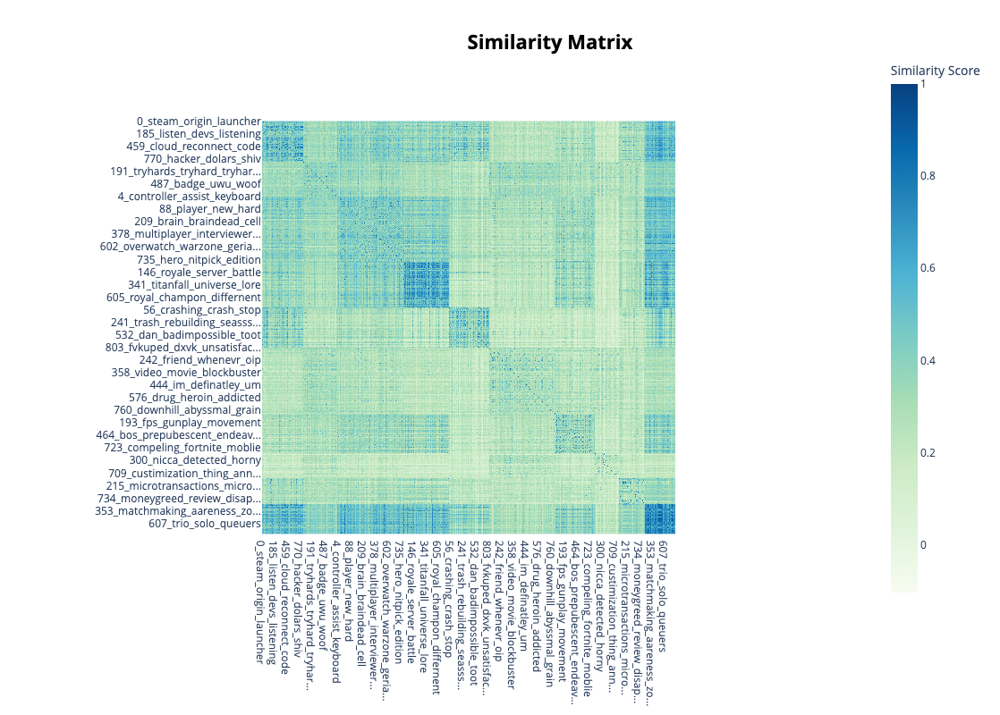

In [109]:
topic_model.visualize_heatmap(n_clusters=10)

## Testing with some random reviews

In [111]:
text = "The soundtrack is playful, dramatic, tragic, serene, unsettling, and epic all at once. Music that has the ability to convey the emotions of a story, and then enhance the listeners experience of the game is what makes a good soundtrack. The Witcher 3 soundtrack does both these things incredibly well.."
preds, probs = topic_model.transform(text)
print(preds)

[594]


In [112]:
top_topic = preds[0]
print(topic_model.get_topic(top_topic))

[['soundtrack', 0.39426743914390494], ['humming', 0.33526806455092434], ['tune', 0.2646159780845782], ['immersive', 0.17819049134646162], ['music', 0.13928051737898367], ['breezin', 0.07933526292515836], ['wiyh', 0.07933526292515836], ['vibin', 0.07226661904007058], ['aston', 0.07226661904007058], ['freeway', 0.07226661904007058]]


In [114]:
topic_model.get_topic_info(594)

,Topic,Count,Name,Representation,Representative_Docs
0,594,14,594_soundtrack_humming_tune_immersive,"[soundtrack, humming, tune, immersive, music, ...",NaN


In [115]:
text = "This game is so buggy. I am not going to play it anymore! Wasted my money and time on this stupid game"
preds, probs = topic_model.transform(text)
print(preds)

[11]


In [116]:
topic_model.get_topic_info(11)

,Topic,Count,Name,Representation,Representative_Docs
0,11,465,11_bug_buggy_glitch_fix,"[bug, buggy, glitch, fix, minor, breaking, ind...",NaN


In [122]:
text  = "Man, the audio in Apex Legends can be super hit or miss. Sometimes footsteps sound like they're right next to you, but the enemy is way across the map. Or worse, you get snuck up on because the sound just didn’t play at all. It's frustrating, especially in a game where hearing is so key to survival. I hope they fix it soon because it can totally throw off your game when you can't rely on the sound cues!"
preds, probs = topic_model.transform(text)
print(preds)

[2]


In [124]:
topic_model.get_topic_info(2)

,Topic,Count,Name,Representation,Representative_Docs
0,2,1368,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN


In [368]:
steam_reviews_bert.head()

,author,review,timestamp_created,timestamp_updated,voted_up,review_length,clean_review,clean_review_str
0,"{'steamid': '76561198273957109', 'num_games_ow...",doesnt launch with origin\n\nedit: easy anti-c...,2020-11-05,2021-11-19,1.0,58,"[doe, launch, origin, edit, easy, anti, cheat,...",doe launch origin edit easy anti cheat banned ...
1,"{'steamid': '76561198091477605', 'num_games_ow...","Now with the new battle pass system, I'm delet...",2024-07-08,2024-07-08,0.0,17,"[new, battle, pas, system, deleting, well, pla...",new battle pas system deleting well player bye
2,"{'steamid': '76561198295880474', 'num_games_ow...",Game freezes every session i play with the new...,2024-06-27,2024-06-27,0.0,13,"[freeze, every, session, new, update, literall...",freeze every session new update literally unpl...
3,"{'steamid': '76561198016708638', 'num_games_ow...",You open the game and finish your 3000 word es...,2022-01-28,2022-01-28,1.0,315,"[open, finish, word, essay, due, tomorrow, loa...",open finish word essay due tomorrow load main ...
4,"{'steamid': '76561199442688562', 'num_games_ow...","Apex is like your neighbor's sister, she treat...",2024-07-19,2024-07-19,0.0,66,"[neighbor, sister, treat, utmost, tenderness, ...",neighbor sister treat utmost tenderness bring ...


In [37]:
steam_reviews_bert.to_csv('./topic_modelling_BERTopic.csv')

# Finalizing Topic and Convert it into a DF

In [38]:
apex_df = pd.read_csv('./topic_modelling_BERTopic.csv', index_col=0)

In [39]:
apex_df.head()

,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_created,timestamp_updated,voted_up,comment_count,review_length,clean_review,clean_review_str
0,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,2020-11-05,2021-11-19,1.0,117,58,"['doe', 'launch', 'origin', 'edit', 'easy', 'a...",doe launch origin edit easy anti cheat banned ...
1,76561198091477605,29,4,99460,"Now with the new battle pass system, I'm delet...",2024-07-08,2024-07-08,0.0,77,17,"['new', 'battle', 'pas', 'system', 'deleting',...",new battle pas system deleting well player bye
2,76561198295880474,41,4,40661,Game freezes every session i play with the new...,2024-06-27,2024-06-27,0.0,0,13,"['freeze', 'every', 'session', 'new', 'update'...",freeze every session new update literally unpl...
3,76561198016708638,160,36,33212,You open the game and finish your 3000 word es...,2022-01-28,2022-01-28,1.0,59,315,"['open', 'finish', 'word', 'essay', 'due', 'to...",open finish word essay due tomorrow load main ...
4,76561199442688562,43,1,85469,"Apex is like your neighbor's sister, she treat...",2024-07-19,2024-07-19,0.0,11,66,"['neighbor', 'sister', 'treat', 'utmost', 'ten...",neighbor sister treat utmost tenderness bring ...


In [40]:
apex_df.drop(columns=['timestamp_created', 'review_length', 'clean_review', 'clean_review_str'], inplace=True)

In [41]:
apex_df.head()

,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_updated,voted_up,comment_count
0,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,2021-11-19,1.0,117
1,76561198091477605,29,4,99460,"Now with the new battle pass system, I'm delet...",2024-07-08,0.0,77
2,76561198295880474,41,4,40661,Game freezes every session i play with the new...,2024-06-27,0.0,0
3,76561198016708638,160,36,33212,You open the game and finish your 3000 word es...,2022-01-28,1.0,59
4,76561199442688562,43,1,85469,"Apex is like your neighbor's sister, she treat...",2024-07-19,0.0,11


In [131]:
# topic_model = BERTopic.load("./bertopic_model")

No sentence-transformers model found with name bertopic_model. Creating a new one with MEAN pooling.
2024-10-19 11:56:14,142 - BERTopic - WARNING: You are loading a BERTopic model without explicitly defining an embedding model.If you want to also load in an embedding model, make sure to useBERTopic.load(my_model, embedding_model=my_embedding_model).


In [42]:
df_topics = pd.DataFrame(topic_model.get_document_info(apex_df['review']))

mapping = {2 : 'Audio Reliability', 8: 'Genre', 11: 'Technical Stability', 20:'Cross-Platform', 32: 'Gameplay Mechanics'}

# Replace values in the 'Topic' column
df_topics['Topic'] = df_topics['Topic'].replace(mapping)

df_topics[df_topics['Topic'] == 'Audio Reliability']['Document'].iloc[:]

df_topics.head()

# df_topics[df_topics['Topic'] == 'Combat/Gameplay']

,Document,Topic,Name,Representation,Representative_Docs,Top_n_words,Representative_document
0,doesnt launch with origin\n\nedit: easy anti-c...,1,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN,banned - ban - account - hacked - perma - reas...,False
1,"Now with the new battle pass system, I'm delet...",308,308_deleting_bye_spin_button,"[deleting, bye, spin, button, pas, system, uni...",NaN,deleting - bye - spin - button - pas - system ...,False
2,Game freezes every session i play with the new...,183,183_crashing_update_freeze_crash,"[crashing, update, freeze, crash, crashed, ses...",NaN,crashing - update - freeze - crash - crashed -...,False
3,You open the game and finish your 3000 word es...,267,267_caustic_hamster_menu_ttv,"[caustic, hamster, menu, ttv, zone, juiced, tr...",NaN,caustic - hamster - menu - ttv - zone - juiced...,False
4,"Apex is like your neighbor's sister, she treat...",-1,-1_player_ha_season_new,"[player, ha, season, new, time, skin, get, pla...",NaN,player - ha - season - new - time - skin - get...,False


In [43]:
df_merge = pd.merge(apex_df,df_topics, how='inner', left_on = 'review', right_on = 'Document') 
df_merge = df_merge.drop('Document', axis=1)
df_merge.head()

,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_updated,voted_up,comment_count,Topic,Name,Representation,Representative_Docs,Top_n_words,Representative_document
0,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,2021-11-19,1.0,117,1,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN,banned - ban - account - hacked - perma - reas...,False
1,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,2021-11-19,1.0,117,1,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN,banned - ban - account - hacked - perma - reas...,False
2,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,2021-11-19,1.0,117,1,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN,banned - ban - account - hacked - perma - reas...,False
3,76561198273957109,193,16,32762,doesnt launch with origin\n\nedit: easy anti-c...,2021-11-19,1.0,117,1,1_banned_ban_account_hacked,"[banned, ban, account, hacked, perma, reason, ...",NaN,banned - ban - account - hacked - perma - reas...,False
4,76561198091477605,29,4,99460,"Now with the new battle pass system, I'm delet...",2024-07-08,0.0,77,308,308_deleting_bye_spin_button,"[deleting, bye, spin, button, pas, system, uni...",NaN,deleting - bye - spin - button - pas - system ...,False


In [45]:
apex_5topics = df_merge[df_merge['Topic'].isin(['Audio Reliability', 'Genre', 'Technical Stability', 'Cross-Platform', 'Gameplay Mechanics'])].reset_index(drop=True)
# Rename column Document to review
apex_5topics.rename(columns={'Document': 'review'}, inplace=True)
apex_5topics.head(100)


,author_steamid,author_num_games_owned,author_num_reviews,author_playtime_forever,review,timestamp_updated,voted_up,comment_count,Topic,Name,Representation,Representative_Docs,Top_n_words,Representative_document
0,76561198385631588,0,7,968,I suck at this game and it's difficult as shit...,2021-04-05,1.0,1,Genre,8_royales_royale_battle_probably,"[royales, royale, battle, probably, favourite,...",NaN,royales - royale - battle - probably - favouri...,False
1,76561198874813428,0,2,44180,"Audio Sucks, Tick rate is the worst in gaming ...",2024-07-16,0.0,0,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
2,76561198047389777,814,2,27338,"Maybe if the devs actually listened, fixed sou...",2021-03-08,0.0,0,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
3,76561198040315187,825,28,14559,Best battle royale game on the market in my op...,2020-11-23,1.0,7,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
4,76561198040315187,825,28,14559,Best battle royale game on the market in my op...,2020-11-23,1.0,7,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,76561198890562745,30,2,221411,this game is the most frustrating annoying bug...,2022-01-03,1.0,0,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
96,76561199024429717,85,3,176664,Great game with good mechanics but their match...,2023-11-26,1.0,0,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
97,76561198203400824,0,8,4160,Game has a lot of glitches and has some of the...,2021-11-10,0.0,0,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False
98,76561198220135000,0,2,154966,"Awful glitches, awful matchmaking, so many kno...",2021-10-16,0.0,0,Audio Reliability,2_audio_footstep_sound_hear,"[audio, footstep, sound, hear, bug, fix, issue...",NaN,audio - footstep - sound - hear - bug - fix - ...,False


In [46]:
apex_5topics.iloc[98]['review']

"Awful glitches, awful matchmaking, so many known issues that have been unresolved because respawn doesn't care to fix them, they'd rather try to remove tap strafing and sell overpriced skins in the store.  It was fun for a while, but the matchmaking and game-breaking bugs, audio issues, etc. lately have made it near impossible to enjoy this game at all."

In [1]:
# apex_5topics.to_csv('./topic_modelling_BERTopic.csv')

NameError: name 'apex_5topics' is not defined